# Ecosystem functioning analysis

In [1]:
import pandas as pd
import plotly.express as px
import numpy as np
from sklearn.manifold import MDS
from sklearn.neighbors import DistanceMetric
import matplotlib.pyplot as plt
import seaborn as sns
import dash_bio
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import umap
import umap.plot
from scipy.spatial.distance import pdist, squareform
from matplotlib.dates import DateFormatter, MonthLocator

sns.set_style("white")
# Set font to times new roman and size to 8
sns.set(font="Times New Roman", font_scale=1)

# Create unit conversion for figure sizes
cm = 1/2.54

In this analysis we combine the functional annotation provided by the eggNOG database with the transcript abundances obtained by running kallisto against the de novo assembled metatranscriptome. We'll combine the TPM values of the transcripts annotated to a given functional category and then use the resulting values to calculate the relative abundance of each functional category.

## Data preparation

In [4]:
# Load the annotation data
annotation = pd.read_csv('../../data/annotation/functional_eggnog/functional_annotation.emapper.annotations', sep = '\t', engine = 'pyarrow')

# Fix transcript names in the first column so that they equal the transcript identifiers in the count files
# This is necessary because TransDecoder adds .p2 or .p1 to the sequence identifiers
annotation.iloc[:, 0] = annotation.iloc[:, 0].str.split(".", expand=True).drop(columns=1)

# Load the count data
counts = pd.read_csv('../../data/kallisto/tpm.csv', sep=',', index_col=0, engine='pyarrow')

# load metadata
meta = pd.read_csv('../../samples.csv', sep=';', index_col=0)
## Set the order of the months in the metadata
month_order = ["July_2020", "August_2020", "September_2020", "November_2020", 
                "December_2020", "January_2021", "February_2021", "April_2021", 
                "May_2021", "June_2021", "July_2021"]

In [5]:
annotation.head()

,#query,seed_ortholog,evalue,score,eggNOG_OGs,max_annot_lvl,COG_category,Description,Preferred_name,GOs,...,KEGG_ko,KEGG_Pathway,KEGG_Module,KEGG_Reaction,KEGG_rclass,BRITE,KEGG_TC,CAZy,BiGG_Reaction,PFAMs
0,c_000001511793,7425.NV12798-PA,1.268000e-24,106.0,"KOG3955@1|root,KOG3955@2759|Eukaryota,38B5I@33154|Opisthokonta,3BBTY@33208|Metazoa,3CRXJ@33213|Bilateria,41VIB@6656|Arthropoda,3SIPU@50557|Insecta,46HT5@7399|Hymenoptera",33208|Metazoa,GM,6-O-sulfation enzyme which catalyzes the transfer of sulfate from 3'-phosphoadenosine 5'-phosphosulfate (PAPS) to position 6 of the N-sulfoglucosamine residue (GlcNS) of heparan sulfate,HS6ST1,"GO:0000003,GO:0000139,GO:0000166,GO:0001525,GO:0001568,GO:0001569,GO:0001654,GO:0001701,GO:0001763,GO:0001890,GO:0001892,GO:0001944,GO:0002009,GO:0002165,GO:0003006,GO:0003674,GO:0003824,GO:0005488,GO:0005575,GO:0005622,GO:0005623,GO:0005634,GO:0005654,GO:0005737,GO:0005794,GO:0005886,GO:0005887,GO:0006022,GO:0006023,GO:0006024,GO:0006029,GO:0006807,GO:0007275,GO:0007399,GO:0007423,GO:0007424,GO:0007444,GO:0007472,GO:0007476,GO:0007552,GO:0007560,GO:0008146,GO:0008150,GO:0008152,GO:0008587,GO:0009058,GO:0009059,GO:0009100,GO:0009101,GO:0009653,GO:0009790,GO:0009791,GO:0009792,GO:0009886,GO:0009887,GO:0009888,GO:0009987,GO:0012505,GO:0015012,GO:0015015,GO:0016020,GO:0016021,GO:0016740,GO:0016782,GO:0017076,GO:0017095,GO:0019538,GO:0022008,GO:0022414,GO:0022416,GO:0030154,GO:0030166,GO:0030182,GO:0030201,GO:0030203,GO:0030246,GO:0030323,GO:0030324,GO:0030554,GO:0031090,GO:0031224,GO:0031226,GO:0031974,GO:0031981,GO:0031984,GO:0032501,GO:0032502,GO:0032553,GO:0032555,GO:0032559,GO:0034483,GO:0034645,GO:0035107,GO:0035114,GO:0035120,GO:0035220,GO:0035239,GO:0035295,GO:0036094,GO:0040008,GO:0040014,GO:0040018,GO:0043009,GO:0043167,GO:0043168,GO:0043170,GO:0043226,GO:0043227,GO:0043229,GO:0043231,GO:0043233,GO:0044237,GO:0044238,GO:0044249,GO:0044260,GO:0044422,GO:0044424,GO:0044425,GO:0044428,GO:0044431,GO:0044444,GO:0044446,GO:0044459,GO:0044464,GO:0045570,GO:0045927,GO:0046620,GO:0048048,GO:0048286,GO:0048468,GO:0048513,GO:0048514,GO:0048518,GO:0048562,GO:0048563,GO:0048568,GO:0048569,GO:0048592,GO:0048598,GO:0048608,GO:0048638,GO:0048639,GO:0048646,GO:0048666,GO:0048699,GO:0048707,GO:0048729,GO:0048731,GO:0048736,GO:0048737,GO:0048754,GO:0048856,GO:0048869,GO:0050656,GO:0050789,GO:0050793,GO:0051094,GO:0051239,GO:0051240,GO:0060173,GO:0060429,GO:0060541,GO:0060562,GO:0060674,GO:0060711,GO:0060716,GO:0061138,GO:0061458,GO:0065007,GO:0070013,GO:0070492,GO:0071704,GO:0071944,GO:0072358,GO:0072359,GO:0090596,GO:0097159,GO:0097367,GO:0098588,GO:0098791,GO:1901135,GO:1901137,GO:1901265,GO:1901363,GO:1901564,GO:1901566,GO:1901576,GO:1901681,GO:2000026",...,"ko:K02514,ko:K08102,ko:K08103","ko00534,map00534",-,-,-,"ko00000,ko00001,ko01000,ko01003",-,-,-,Sulfotransfer_2
1,c_000001511845,44056.XP_009036261.1,5.143000e-132,431.0,"COG1219@1|root,KOG0745@2759|Eukaryota",2759|Eukaryota,O,unfolded protein binding,MCX1,"GO:0000166,GO:0003674,GO:0003824,GO:0004176,GO:0005488,GO:0005524,GO:0005575,GO:0005622,GO:0005623,GO:0005737,GO:0005739,GO:0005759,GO:0006457,GO:0006508,GO:0006605,GO:0006626,GO:0006807,GO:0006810,GO:0006839,GO:0006886,GO:0006996,GO:0007005,GO:0008104,GO:0008144,GO:0008150,GO:0008152,GO:0008233,GO:0009056,GO:0009057,GO:0009893,GO:0009987,GO:0010604,GO:0015031,GO:0015833,GO:0016043,GO:0016462,GO:0016787,GO:0016817,GO:0016818,GO:0016887,GO:0017038,GO:0017076,GO:0017111,GO:0019222,GO:0019538,GO:0030150,GO:0030163,GO:0030554,GO:0031323,GO:0031325,GO:0031399,GO:0031401,GO:0031974,GO:0032268,GO:0032270,GO:0032553,GO:0032555,GO:0032559,GO:0033036,GO:0033365,GO:0034613,GO:0035639,GO:0036094,GO:0042026,GO:0042623,GO:0042886,GO:0043167,GO:0043168,GO:0043170,GO:0043226,GO:0043227,GO:0043229,GO:0043231,GO:0043233,GO:0044238,GO:0044422,GO:0044424,GO:0044429,GO:0044444,GO:0044446,GO:0044464,GO:0044743,GO:0045184,GO:0046907,GO:0048518,GO:0048522,GO:0050789,GO:0050794,GO:0051171,GO:0051173,GO:0051179,GO:0051234,GO:0

In [6]:
counts.head()

,B_120_S11,5_120_S50,A_780_S3,5_130_S45,C_ZG02_S17,C_780_S15,2_700_S37,4_120_S44,2_120_S40,E_330_S22,...,C_130_S13,A_120_S5,A_700_S4,B_330_S8,F_700_S26,E_ZG02_S24,7_130_S57,E_130_S19,1_ZG02_S35,B_780_S9
target_id,,,,,,,,,,,,,,,,,,,,,
c_000000000001,0.233985,0.0,0.0,0.0,0.0,0.776557,0.0,0.0,0.0,1.193990,...,0.0,0.0,0.0,0.0,0.0,0.445188,0.0,0.000000,0.0,0.0
c_000000000002,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0
c_000000000003,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0
c_000000000004,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.394599,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0
c_000000000005,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.204867,0.0,0.0


Now, we'll create a new dataframe that consists of rows of functional categories (e.g. KEGG modules, KEGG KO identifiers, etc.) and columns of samples. The values are the summed TPM counts of that given functional category in that given sample. This data is stored and later used in WGCNA analysis and here for an exploratory clustering analysis. 

In [7]:
# Uncomment the column of interest from the annotation data:
functional_category = 'KEGG_ko'
#functional_category = 'PFAMs'

# Combine relevant parts of both dataframes
# Transform the count data to the long format
data = counts.reset_index().melt(id_vars=['target_id'],var_name='sample', value_name='TPM')
# Add functional information to the new set
data = data.merge(annotation[['#query', functional_category]], left_on = "target_id", right_on="#query", how='left')
# Rename the transcript identifier column
data = data.rename(columns={'target_id': 'Name'})
# Cleanup & drop contigs without annotation
data = data[data[functional_category].notna()]
data = data[data[functional_category] != '-']
data = data.drop(columns=['#query'])

In [ ]:
# Inspect how this looks like
data.head()

,Name,sample,TPM,KEGG_ko
201,c_000000000202,B_120_S11,0.000000,ko:K09488
203,c_000000000204,B_120_S11,0.191288,ko:K01373
204,c_000000000205,B_120_S11,0.000000,"ko:K04670,ko:K13596"
225,c_000000000227,B_120_S11,0.000000,ko:K17086
231,c_000000000233,B_120_S11,0.000000,ko:K15283


In [ ]:
# Comment or uncomment the following line if multiple values are assigned to a transcript!
## split them up
data = data.assign(**{functional_category:data[functional_category].str.split(',')})
# Now we can explode the functional column
data = data.explode(functional_category)
# Cut off that weird part of the identifier, if necessary!
data.iloc[:, -1] = data.iloc[:, -1].str.split(":", expand=True).drop(columns=0)

# Group by functional information and sample values, sum TPM
data = data.groupby([functional_category, 'sample'])['TPM'].sum()
# Create the matrix
data = data.reset_index().pivot(index=functional_category, columns='sample')['TPM']

In [ ]:
# Inspect the resulting matrix
data.head()

sample,1_130_S31,1_330_S34,1_700_S32,1_780_S33,1_ZG02_S35,2_120_S40,2_130_S36,2_330_S39,2_700_S37,2_780_S38,...,E_330_S22,E_700_S20,E_780_S21,E_ZG02_S24,F_120_S29,F_130_S25,F_330_S28,F_700_S26,F_780_S27,F_ZG02_S30
KEGG_ko,,,,,,,,,,,,,,,,,,,,,
K00001,6.349553,6.280845,5.722522,16.470693,6.781363,10.591946,24.171424,8.368717,4.103096,15.618417,...,7.965802,11.844140,19.507110,9.739255,3.883122,4.853716,15.122069,7.502427,13.989276,10.996971
K00002,48.008260,77.066243,6.029602,44.367151,42.899407,47.575724,62.763489,34.652092,17.196408,44.596553,...,62.465061,66.351346,106.757220,44.048946,20.726597,32.025368,51.132772,59.883515,47.736096,42.078717
K00003,1.782063,4.391800,0.318078,4.455470,4.340363,19.281839,15.969721,19.691710,1.720801,10.011262,...,7.614368,4.038272,8.071965,7.030187,11.717234,8.592969,5.014926,3.053213,18.726575,15.858242
K00004,0.000000,1.927079,0.206101,1.295805,0.604348,1.160494,0.000000,0.000000,0.000000,0.605782,...,0.324470,0.313300,2.960118,0.733456,0.376088,0.343146,0.293504,0.330932,0.000000,0.935515
K00005,0.993464,1.181118,0.530515,2.395785,0.724514,3.731287,2.399398,1.220265,1.434257,4.637575,...,1.862327,3.129495,0.834840,2.956393,4.468286,0.472382,8.849879,2.979598,1.036524,4.796266


In [ ]:
# Write the data to a file
data.to_csv(f'../../data/analysis/{functional_category}_TPM_sum.csv')

# Write the transposed data to a file
data.transpose().to_csv(f'../../data/analysis/{functional_category}_TPM_sum_transposed.csv')

### Preprocessing the metatranscriptome

<AxesSubplot:>

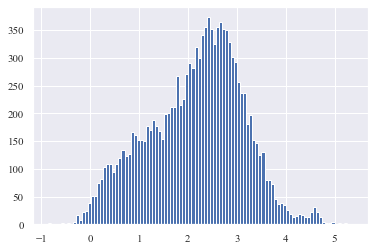

In [ ]:
# Note: From the ERCC analysis, we know that the lower limit of detection is +- 1 TPM
# Plot the log10 of the row sums
data.sum(axis=1).apply(np.log10).hist(bins=100)

Most of the functional identifiers have very low counts across samples. Maybe a lot of the functional categories are present only in a couple of samples. Let's check the distribution of values in general to see whether it makes sense to filter out low abundance functional categories.

array([[<AxesSubplot:title={'center':'7_120_S61'}>]], dtype=object)

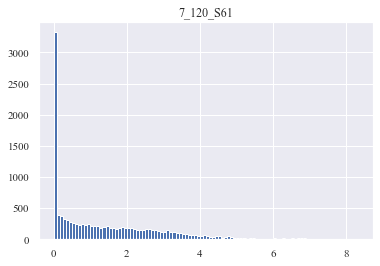

In [ ]:
# Plot the log10 of some random columns
log_sample = np.log(data.sample(1, axis=1) +1)
log_sample.hist(bins=100)

## Data exploration

In [2]:
functional_category = 'KEGG_ko'
# Read the data
data = pd.read_csv(f'../../data/analysis/{functional_category}_TPM_sum.csv', index_col=0)

# Remove noisy functional categories (values < 1) to remove noise below the detection limit
data[data < 1] = 0
# Remove rows with only zeros
data = data[data.sum(axis=1) != 0]

# log transform the transposed data
data_log = np.log(data.transpose() +1)

# load metadata
meta = pd.read_csv('../../samples.csv', sep=';', index_col=0)
## Set the order of the months in the metadata
month_order = ["July_2020", "August_2020", "September_2020", "November_2020", 
                "December_2020", "January_2021", "February_2021", "April_2021", 
                "May_2021", "June_2021", "July_2021"]

# Check if the indices are the same
assert (data_log.index == meta.index).all()

### MDS

/opt/homebrew/lib/python3.9/site-packages/sklearn/neighbors/_distance_metric.py:10: FutureWarning: sklearn.neighbors.DistanceMetric has been moved to sklearn.metrics.DistanceMetric in 1.0. This import path will be removed in 1.3
  warnings.warn(


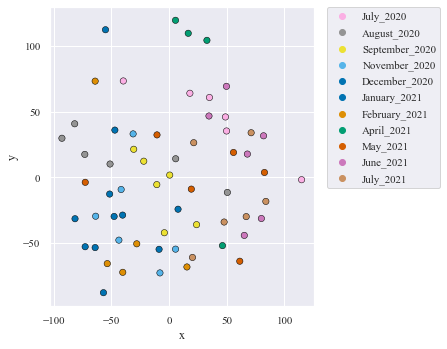

In [ ]:
# Create distance matrix, should be samples x samples
dist = DistanceMetric.get_metric('euclidean')
dist_matrix = dist.pairwise(data_log)

# MDS
mds = MDS(n_components=2, dissimilarity='precomputed')
n_mds = mds.fit_transform(dist_matrix)

# Combine data
plot_df = pd.DataFrame(n_mds, columns=('x', 'y'))
plot_df['month'] = [str(x) for x in meta.month]

# Create a color dictionary for the months
month_color_dict = dict(zip(meta['month'].unique(), sns.color_palette('colorblind', n_colors=len(meta['month'].unique()))))

# Plot
# Set figure size and font scale
plt.figure(figsize=(12*cm, 14*cm))
           
fig = sns.scatterplot(data = plot_df,
                    x = 'x',
                    y = 'y',
                    hue = 'month',
                    hue_order = month_order,
                    palette = month_color_dict,
                    s = 40, edgecolor = 'black', linewidth = 0.5)

plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)

# Save the figure as svg
plt.savefig(f'../../figures/functional_analysis/{functional_category}_MDS.svg', format='svg', bbox_inches='tight')

## Data exploration: PCA

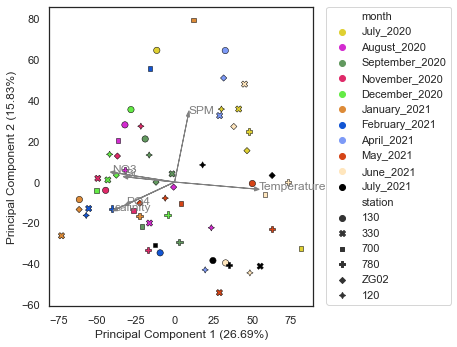

In [7]:
# Merge environmental variables with gene expression data
env_variables = pd.read_csv("../../data/environmental/samples_env.csv", sep=";")
env_variables = env_variables.set_index('sample')
pca_data = data_log.merge(env_variables, left_index=True, right_on='sample', how='left')

# Perform PCA on gene expression data, ignore columns that are also in the environmental variables
pca = PCA(n_components=3)
principalComponents = pca.fit_transform(pca_data.drop(columns=env_variables.columns))

# Add principal components to the data
pca_data['PC1'] = principalComponents[:, 0]
pca_data['PC2'] = principalComponents[:, 1]

# Create a color dictionary for the months
month_color_dict = {
    'July_2020':            "#dfd032",
    'August_2020':          "#d32bd0",
    'September_2020':       "#62995f",
    'November_2020':        "#df2a69",
    'December_2020':        "#64eb46",
    'January_2021':         "#dd8b38",
    'February_2021':        "#1255d3",
    'April_2021':           "#7d9af7",
    'May_2021':             "#d54416",
    'June_2021':            "#ffe6bd",
    'July_2021':            "#000000"
}

# Set figure size and font scale
plt.figure(figsize=(12*cm, 14*cm))

# Plot PCA biplot with the color of the month corrresponding to the month of the sample
# and the shape of the point corresponding to the station of the sample
sns.set(style='white', font_scale=1)
sns.scatterplot(data=pca_data,
                x='PC1',
                y='PC2',
                hue='month',
                hue_order=month_order,
                style='station',
                palette=month_color_dict,
                s=40, edgecolor='black', linewidth=0.5)

plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)

# Plot labels with the variance explained by each principal component
plt.xlabel('Principal Component 1 ({}%)'.format(round(pca.explained_variance_ratio_[0] * 100, 2)))
plt.ylabel('Principal Component 2 ({}%)'.format(round(pca.explained_variance_ratio_[1] * 100, 2)))

# Plot arrows indicating the correlation between the principal components and the environmental variables
## Linear regression to determine the correlation between the principal components and the environmental variables
columns_of_interest = ['NO3', 'PO4', 'Si', 'SPM', 'salinity', 'Temperature']

# Scale the environmental variables
pca_data[columns_of_interest] = StandardScaler().fit_transform(pca_data[columns_of_interest])

# Calculate the correlation matrix between the principal components and the environmental variables
corr_matrix = np.corrcoef(pca_data[['PC1', 'PC2'] + columns_of_interest].dropna().T)

# Get the correlation between the first two principal components and each environmental parameter
corr_PC1_env = corr_matrix[0, 2:]
corr_PC2_env = corr_matrix[1, 2:]

# Plot the arrows representing the correlations
for i, env_param in enumerate(columns_of_interest):
    plt.arrow(0, 0, corr_PC1_env[i]*max(pca_data['PC1']), corr_PC2_env[i]*max(pca_data['PC2']), head_width=2.0, color='gray')
    # corr_PC1_env[i] specifies the end coordinate of the arrow in the x direction
    # This coordinate is multiplied with max(pca_data['PC1']) to scale the arrow to the length of the principal component for visualization
    plt.text(corr_PC1_env[i]*max(pca_data['PC1'])*1.05, corr_PC2_env[i]*max(pca_data['PC2'])*1.05, env_param, fontsize=12, color='gray')
    # Same as above, but the text is placed 5% further away from the arrow

# Save the figure as svg
plt.savefig(f'../../figures/functional_analysis/{functional_category}_PCA_biplot.svg', format='svg', bbox_inches='tight')

plt.show()

In [96]:
pca.explained_variance_ratio_[2] * 100

7.981161994733665

## Data exploration: UMAP

OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


<AxesSubplot:>

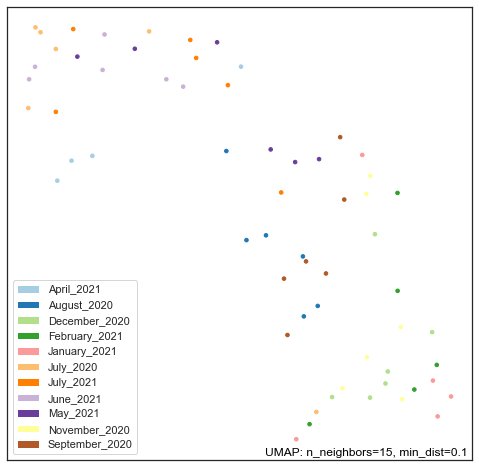

In [97]:
# Merge environmental variables with gene expression data
env_variables = pd.read_csv("../../data/environmental/samples_env.csv", sep=";")
env_variables = env_variables.set_index('sample')
umap_data = data_log.merge(env_variables, left_index=True, right_on='sample', how='left')

# Perform UMAP on gene expression data, ignore columns that are also in the environmental variables
mapper = umap.UMAP(n_components=2, random_state = 42).fit(data_log)

# Plot
umap.plot.points(mapper, labels=umap_data['month'], color_key_cmap='Paired', background='white', width=600, height=600)

<AxesSubplot:title={'center':'Colored by RGB coords of PCA embedding'}>

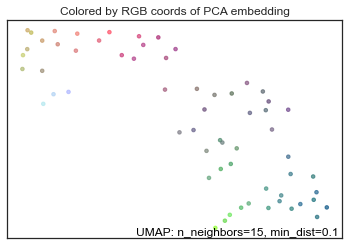

In [98]:
umap.plot.diagnostic(mapper, diagnostic_type='pca')

## Data exploration: clustergram

For this, we best use variance-stabilized data. We can use the `vst` function from the `DESeq2` package for this. Let's run the <a href="variance_stabilizing_transformation.R">script</a> on the data we just created.

In [99]:
data_vst = pd.read_csv(f'../../data/analysis/{functional_category}_TPM_vst.csv', index_col=0)

In [100]:
# Check percent of rows with only zeros
len(data_vst.loc[(data_vst == 0).all(axis=1)]) / len(data_vst)

0.0

<AxesSubplot:>

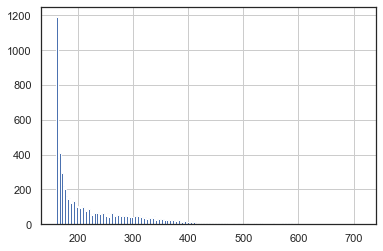

In [101]:
# Plot distribution of row sums
data_vst.sum(axis=1).hist(bins=200)

In [102]:
# Log transform data
plot_data = np.log2(data_vst + 1)

dash_bio.Clustergram(
    data=plot_data,
    column_labels=list(plot_data.columns.values),
    row_labels=list(plot_data.index),
    height=1600,
    width=1400,
    center_values=False, # This ensures the displayed values are the original count values instead of the distance matrix values
    hidden_labels='row'
)

This is a bit hard to interpret, maybe we can improve this by averaging samples per month.

In [103]:
# Load appropriate data
functional_category = 'KEGG_ko'
data = pd.read_csv(f'../../data/analysis/{functional_category}_TPM_sum.csv', index_col=0)

# Sum spatial samples together per month
july_2020 = ['A_120_S5', 'A_130_S1', 'A_330_S2','A_700_S4', 'A_780_S3', 'A_ZGO2_S6']
august_2020 = ['B_120_S11', 'B_130_S7', 'B_330_S8', 'B_700_S10', 'B_780_S9', 'B_ZG02_S12']
september_2020 = ['C_120_S18','C_130_S13', 'C_330_S16', 'C_700_S14', 'C_780_S15', 'C_ZG02_S17'] 
november_2020 = ['E_120_S23', 'E_130_S19', 'E_330_S22', 'E_700_S20', 'E_780_S21', 'E_ZG02_S24']
december_2020 = ['F_120_S29', 'F_130_S25', 'F_330_S28', 'F_700_S26', 'F_780_S27', 'F_ZG02_S30']
january_2021 =  ['1_130_S31', '1_330_S34', '1_700_S32', '1_780_S33', '1_ZG02_S35']
february_2021 = ['2_120_S40', '2_130_S36', '2_330_S39', '2_700_S37', '2_780_S38']
april_2021 = ['4_120_S44', '4_130_S41', '4_330_S42', '4_ZG02_S43']
may_2021 = ['5_120_S50','5_130_S45', '5_330_S48', '5_700_S46', '5_780_S47', '5_ZG02_S49']
june_2021 = ['6_120_S55', '6_130_S51', '6_330_S52', '6_700_S53', '6_780_S54', '6_ZG02_S56']
july_2021 = ['7_120_S61', '7_130_S57', '7_330_S58', '7_700_S59','7_780_S60', '7_ZG02_S62']

data_month_average = pd.DataFrame()
data_month_average['july_2020'] = data[july_2020].mean(axis=1)
data_month_average['august_2020'] = data[august_2020].mean(axis=1)
data_month_average['september_2020'] = data[september_2020].mean(axis=1)
data_month_average['november_2020'] = data[november_2020].mean(axis=1)
data_month_average['december_2020'] = data[december_2020].mean(axis=1)
data_month_average['january_2021'] = data[january_2021].mean(axis=1)
data_month_average['february_2021'] = data[february_2021].mean(axis=1)
data_month_average['april_2021'] = data[april_2021].mean(axis=1)
data_month_average['may_2021'] = data[may_2021].mean(axis=1)
data_month_average['june_2021'] = data[june_2021].mean(axis=1)
data_month_average['july_2021'] = data[july_2021].mean(axis=1)

data_month_sum = pd.DataFrame()
data_month_sum['july_2020'] = data[july_2020].sum(axis=1)
data_month_sum['august_2020'] = data[august_2020].sum(axis=1)
data_month_sum['september_2020'] = data[september_2020].sum(axis=1)
data_month_sum['november_2020'] = data[november_2020].sum(axis=1)
data_month_sum['december_2020'] = data[december_2020].sum(axis=1)
data_month_sum['january_2021'] = data[january_2021].sum(axis=1)
data_month_sum['february_2021'] = data[february_2021].sum(axis=1)
data_month_sum['april_2021'] = data[april_2021].sum(axis=1)
data_month_sum['may_2021'] = data[may_2021].sum(axis=1)
data_month_sum['june_2021'] = data[june_2021].sum(axis=1)
data_month_sum['july_2021'] = data[july_2021].sum(axis=1)

# Save the data to a file
data_month_average.to_csv(f'../../data/analysis/{functional_category}_TPM_month_average.csv')
data_month_sum.to_csv(f'../../data/analysis/{functional_category}_TPM_month_sum.csv')

# If needed, run the r script on this file to obtain vst transformed data
# Note that this scripts also removes rows with only zeros

In [104]:
# Load appropriate data
data_month_average = pd.read_csv(f'../../data/analysis/{functional_category}_TPM_month_average.csv', index_col=0)

# Prepare data for plotting, set everything below 1 to 0
plot_data = data_month_average.copy()
plot_data[plot_data < 1] = 0
# Remove rows with only zeros
plot_data = plot_data.loc[(plot_data != 0).any(axis=1)]

# Log transform data
plot_data = np.log10(plot_data + 1)

fig = dash_bio.Clustergram(
    data=plot_data,
    column_labels=list(plot_data.columns.values),
    row_labels=list(plot_data.index),
    height=800,
    width=700,
    center_values=False, # This ensures the displayed values are the original count values instead of the distance matrix values
    hidden_labels='row'
)

fig.update_layout(
    font=dict(
        family="Times New Roman, serif",  # Set the font family to Times New Roman
        size=12,  # Set the font size
        color="#7f7f7f"  # Set the font color
    ),
    autosize=False,
    width=600,
    height=400,
    margin=dict( # Set the margins
        l=0,  # Left margin
        r=25,  # Right margin
        b=25,  # Bottom margin
        t=25  # Top margin
    ),
    showlegend=False,
    xaxis_title_text='Month',
    yaxis_title_text=functional_category
)

fig.show()

# Save figure as png
fig.write_image(f'../../figures/functional_analysis/{functional_category}_TPM_month_average_clustergram.svg', scale=1)

### Functional categories per month
Now, I want to create a plot with the months on the x-axis, the amount of unique functional IDs for PFAMs and KEGG KOs on the y-axis, coloured by the functional category.

In [105]:
# Combine relevant parts of both dataframes
# Transform the count data to the long format
data = counts.reset_index().melt(id_vars=['target_id'],var_name='sample', value_name='TPM')
data.columns = ['Name', 'sample', 'TPM']

## Add KEGG annotation to the new set
data = data.merge(annotation[['#query', 'KEGG_ko']], left_on = "Name", right_on="#query", how='left')
# Filter out rows without KEGG annotation
data = data[data['KEGG_ko'].notna()]
data = data[data['KEGG_ko'] != '-']
data = data.drop(columns=['#query'])

# Set everything below the detection limit to 0
data.loc[data['TPM'] < 1, 'TPM'] = 0
# Remove rows with only zeros
data = data[data['TPM'] != 0]

# Process the KEGG annotation
# split KO ids up
data['KEGG_ko'] = data['KEGG_ko'].str.split(',')
# Now we can explode the functional column
data = data.explode('KEGG_ko')
# Cut off that weird part of the identifier, if necessary!
data['KEGG_ko'] = data['KEGG_ko'].str.split(':', expand=True).iloc[:, -1]

# Group by functional information and sample values, sum TPM
data = data.groupby(['KEGG_ko', 'sample'])['TPM'].sum().reset_index()

# Save the data to a file
data = data.to_csv(f'../../data/analysis/KEGG_ko_sample_long.csv')

In [106]:
## Add PFAM annotation to the new set
data = counts.reset_index().melt(id_vars=['target_id'],var_name='sample', value_name='TPM')
data = data.merge(annotation[['#query', 'PFAMs']], left_on = "target_id", right_on="#query", how='left')

# Filter out rows without PFAM annotation
data = data[data['PFAMs'].notna()]
data = data[data['PFAMs'] != '-']
data = data.drop(columns=['#query', 'target_id'])

# Set everything below the detection limit to 0
data.loc[data['TPM'] < 1, 'TPM'] = 0
# Remove rows with only zeros
data = data[data['TPM'] != 0]

# Group by functional information and sample values, sum TPM
data = data.groupby(['PFAMs', 'sample'])['TPM'].sum().reset_index()

# Save the data to a file
data = data.to_csv(f'../../data/analysis/PFAMs_sample_long.csv')

In [107]:
# Read in the 2 dataframes 
data1 = pd.read_csv('../../data/analysis/KEGG_ko_sample_long.csv')
data2 = pd.read_csv('../../data/analysis/PFAMs_sample_long.csv')
# Remove the first column
data1 = data1.drop(columns=['Unnamed: 0'])

# Add the metadata
meta = pd.read_csv('../../samples.csv', sep=';', index_col=0)

# TPM is 1 if expressed > TPM, otherwise 0
data1.loc[data1['TPM'] < 1, 'TPM'] = 0
data1.loc[data1['TPM'] >= 1, 'TPM'] = 1
data2.loc[data2['TPM'] < 1, 'TPM'] = 0
data2.loc[data2['TPM'] >= 1, 'TPM'] = 1

# Group by sample, count the number of expressed genes
data1_grouped = data1[['sample', 'TPM']].groupby(['sample'])['TPM'].sum().reset_index()
data2_grouped = data2[['sample', 'TPM']].groupby(['sample'])['TPM'].sum().reset_index()

combined = data1_grouped.merge(data2_grouped, on='sample')
combined.columns = ['sample', 'KEGG_ko', 'PFAMs']

# Add the metadata
combined = combined.merge(meta, on='sample')

combined.head()

,sample,KEGG_ko,PFAMs,date,time,month,station
0,1_130_S31,6328.0,5890.0,18/01/2021,9:05,January_2021,130
1,1_330_S34,6805.0,5929.0,18/01/2021,14:05,January_2021,330
2,1_700_S32,3644.0,3806.0,18/01/2021,11:45,January_2021,700
3,1_780_S33,5499.0,5180.0,18/01/2021,13:00,January_2021,780
4,1_ZG02_S35,6125.0,5309.0,18/01/2021,15:35,January_2021,ZG02


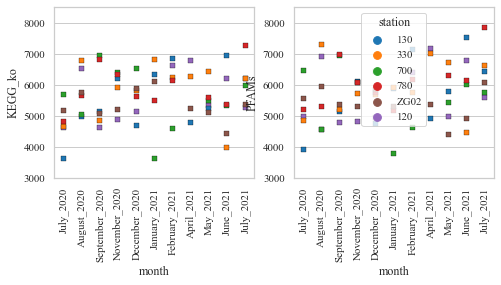

In [110]:
# Set the figure style to 'whitegrid'
sns.set_style('whitegrid')

# Set the font and font size
plt.rcParams['font.family'] = 'Times New Roman'
plt.rcParams['font.size'] = 8

# Define the color dictionary
color_dict = {
    'ZG02': '#8c564b',
    '120': '#9467bd',
    '330': '#ff7f0e',
    '130': '#1f77b4',
    '780': '#d62728',
    '700': '#2ca02c'
}

# Convert size from cm to inches
width = 20 / 2.54  # Width in inches
height = 8 / 2.54  # Height in inches

# Make a stripplot per dataset
fig, ax = plt.subplots(1, 2, figsize=(width, height), sharey=False)

# Add the first dataset to the left plot
sns.stripplot(
    data=combined,
    x='month',
    y='KEGG_ko',
    hue='station',
    palette=color_dict,
    order=month_order,
    marker='s',
    size=5,
    edgecolor='black',
    linewidth=0.3,
    jitter=False,
    ax=ax[0]
)

# Add the second dataset to the right plot
sns.stripplot(
    data=combined,
    x='month',
    y='PFAMs',
    hue='station',
    palette=color_dict,
    order=month_order,
    marker='s',
    size=5,
    edgecolor='black',
    linewidth=0.3,
    jitter=False,
    ax=ax[1]
)

# Rotate the x-axis labels
ax[0].tick_params(axis='x', rotation=90)
ax[1].tick_params(axis='x', rotation=90)

# Remove the legend from the left plot
ax[0].get_legend().remove()

# Set y axis range for the both plots
ax[0].set_ylim(3000, 8500)
ax[1].set_ylim(3000, 8500)

# Save figure as svg with a given size
fig = plt.gcf()  # Get the current figure
fig.set_size_inches(width, height)  # Set the figure size in inches
fig.savefig('../../figures/functional_analysis/functional_annotation_per_month.svg', format='svg', dpi=600)

plt.show()

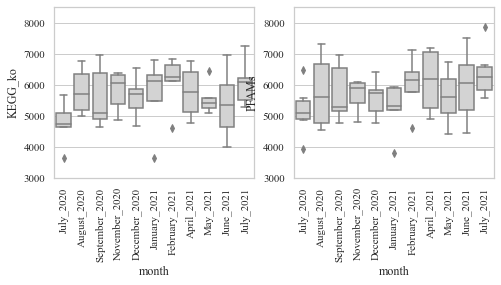

In [111]:
# Make a boxplot per dataset
fig, ax = plt.subplots(1, 2, figsize=(width, height), sharey=False)

# Add the first dataset to the left plot
sns.boxplot(
    data=combined,
    x='month',
    y='KEGG_ko',
    color='lightgray',
    order=month_order,
    ax=ax[0]
)

# Add the second dataset to the right plot
sns.boxplot(
    data=combined,
    x='month',
    y='PFAMs',
    color='lightgray',
    order=month_order,
    ax=ax[1]
)

# Rotate the x-axis labels
ax[0].tick_params(axis='x', rotation=90)
ax[1].tick_params(axis='x', rotation=90)

# Set y axis range for the both plots
ax[0].set_ylim(3000, 8500)
ax[1].set_ylim(3000, 8500)

# Save figure as svg with a given size
fig = plt.gcf()  # Get the current figure
fig.set_size_inches(width, height)  # Set the figure size in inches
fig.savefig('../../figures/functional_analysis/functional_annotation_per_month_boxplot.svg', format='svg', dpi=600)

plt.show()

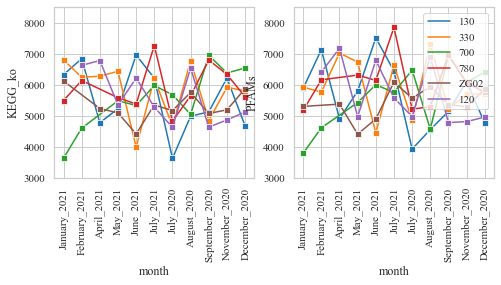

In [112]:
# Set up the plots
fig, ax = plt.subplots(1, 2, figsize=(width, height), sharey=False)

# Line plots (connect stations with lines)
sns.lineplot(
    data=combined,
    x='month',
    y='KEGG_ko',
    hue='station',
    palette=color_dict,
    marker='s',
    ax=ax[0],
    legend=False,
    markers=True
)

sns.lineplot(
    data=combined,
    x='month',
    y='PFAMs',
    hue='station',
    palette=color_dict,
    marker='s',
    ax=ax[1],
    markers=True
)

# Rest of the configurations, including x-axis rotations, y-axis limits, and saving
ax[0].tick_params(axis='x', rotation=90)
ax[1].tick_params(axis='x', rotation=90)
ax[0].set_ylim(3000, 8500)
ax[1].set_ylim(3000, 8500)
ax[1].legend(loc='upper right')

fig.savefig('../../figures/functional_analysis/functional_annotation_per_month_2.svg', format='svg', dpi=600)
plt.show()

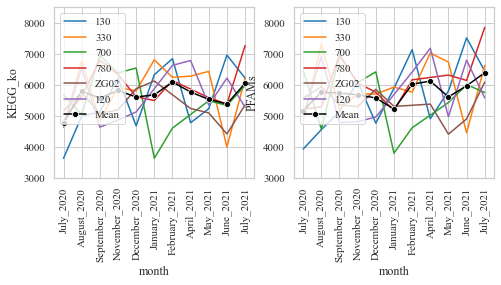

In [113]:
# Assuming month_order is defined somewhere above in your code
combined['month'] = pd.Categorical(combined['month'], categories=month_order, ordered=True)

# Calculate mean values for each month
mean_df = combined.groupby('month').mean().reset_index()

# Set up the plots
fig, ax = plt.subplots(1, 2, figsize=(width, height), sharey=False)

# Line plot for the mean across stations
sns.lineplot(
    data=combined,
    x='month',
    y='KEGG_ko',
    hue='station',
    palette=color_dict,
    markers=True,
    dashes=False,
    ax=ax[0]
)

sns.lineplot(
    data=combined,
    x='month',
    y='PFAMs',
    hue='station',
    palette=color_dict,
    markers=True,
    dashes=False,
    ax=ax[1]
)

# Highlight the mean with black color
sns.lineplot(
    data=mean_df,
    x='month',
    y='KEGG_ko',
    color='black',
    marker='o',
    ax=ax[0],
    label='Mean'
)

sns.lineplot(
    data=mean_df,
    x='month',
    y='PFAMs',
    color='black',
    marker='o',
    ax=ax[1],
    label='Mean'
)

# Rest of your configurations, including x-axis rotations, y-axis limits
ax[0].tick_params(axis='x', rotation=90)
ax[1].tick_params(axis='x', rotation=90)
ax[0].set_ylim(3000, 8500)
ax[1].set_ylim(3000, 8500)
ax[0].legend(loc='upper left')
ax[1].legend(loc='upper left')

fig.savefig('../../figures/functional_analysis/functional_annotation_mean_per_month.svg', format='svg', dpi=600)
plt.show()

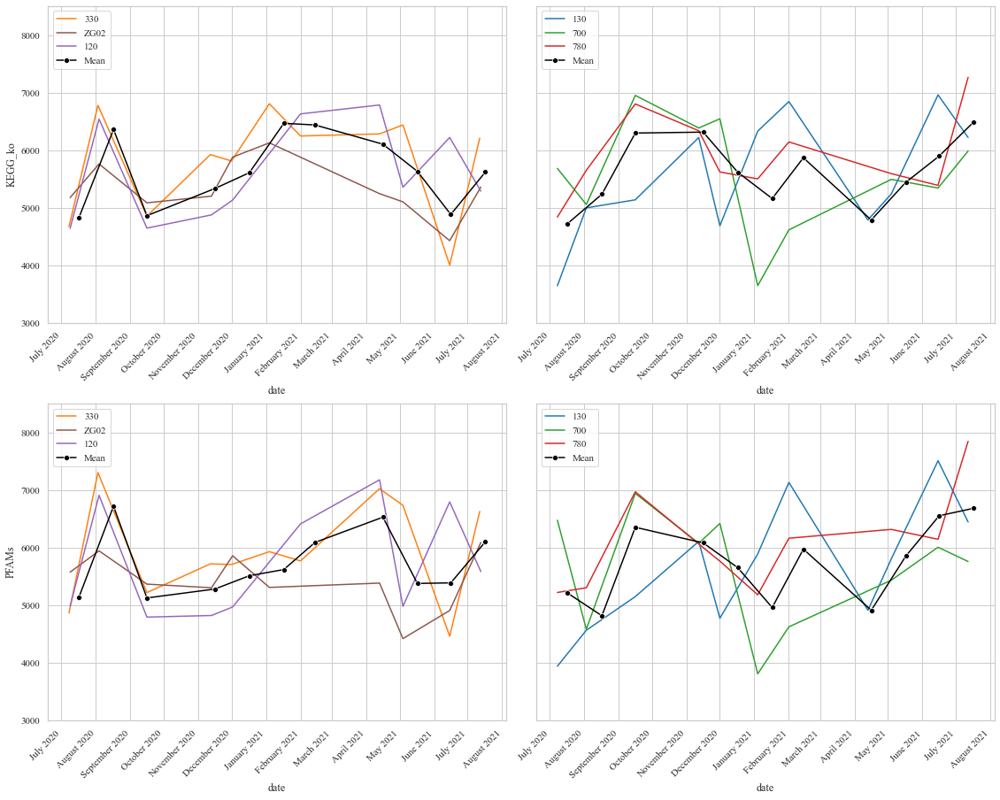

In [114]:
# Read in the 2 dataframes 
data1 = pd.read_csv('../../data/analysis/KEGG_ko_sample_long.csv')
data2 = pd.read_csv('../../data/analysis/PFAMs_sample_long.csv')
# Remove the first column
data1 = data1.drop(columns=['Unnamed: 0'])

# Add the metadata
meta = pd.read_csv('../../samples.csv', sep=';', index_col=0)

# Remove rows with expression values below the detection limit of 1
data1 = data1[data1['TPM'] > 1]
data2 = data2[data2['TPM'] > 1]

# Get a list of KO ids that have an TPM sum > 1 across all samples
tpm_threshold = 1
KO_filtered = data1.groupby('KEGG_ko')['TPM'].sum()
KO_filtered = KO_filtered[KO_filtered > tpm_threshold]

PFAM_filtered = data2.groupby('PFAMs')['TPM'].sum()
PFAM_filtered = PFAM_filtered[PFAM_filtered > tpm_threshold]

# Filter the data
data1 = data1[data1['KEGG_ko'].isin(KO_filtered.index)]
data2 = data2[data2['PFAMs'].isin(PFAM_filtered.index)]

# TPM is 1 if expressed > TPM, otherwise 0
data1.loc[data1['TPM'] < 1, 'TPM'] = 0
data1.loc[data1['TPM'] >= 1, 'TPM'] = 1
data2.loc[data2['TPM'] < 1, 'TPM'] = 0
data2.loc[data2['TPM'] >= 1, 'TPM'] = 1

# Group by sample, count the number of expressed genes
data1_grouped = data1[['sample', 'TPM']].groupby(['sample'])['TPM'].sum().reset_index()
data2_grouped = data2[['sample', 'TPM']].groupby(['sample'])['TPM'].sum().reset_index()

combined = data1_grouped.merge(data2_grouped, on='sample')
combined.columns = ['sample', 'KEGG_ko', 'PFAMs']

# Add the metadata
combined = combined.merge(meta, on='sample')

# Convert the 'date' column to a datetime object
combined['date'] = pd.to_datetime(combined['date'], format='%d/%m/%Y')

# Sort dataframe by date
combined = combined.sort_values(by='date')

# Define lists of stations for each category
nearshore_stations = ['120', 'ZG02', '330']
offshore_stations = ['700', '780', '130']

# Filter the dataframe by the stations
nearshore_df = combined[combined['station'].isin(nearshore_stations)]
offshore_df = combined[combined['station'].isin(offshore_stations)]

# Calculate mean values for each month for both categories
nearshore_mean = nearshore_df.groupby(pd.Grouper(key='date', freq='M')).mean().reset_index()
offshore_mean = offshore_df.groupby(pd.Grouper(key='date', freq='M')).mean().reset_index()

# Set up the plots
## Set plot size in cm
width = 40 / 2.54  # Width in inches
height = 16 / 2.54  # Height in inches

fig, ax = plt.subplots(2, 2, figsize=(width, height*2), sharey=True)

# Plots for KEGG_ko

# Nearshore
sns.lineplot(
    data=nearshore_df,
    x='date',
    y='KEGG_ko',
    hue='station',
    palette=color_dict,
    markers=True,
    dashes=False,
    ax=ax[0, 0]
)
sns.lineplot(
    data=nearshore_mean,
    x='date',
    y='KEGG_ko',
    color='black',
    marker='o',
    ax=ax[0, 0],
    label='Mean'
)

# Offshore
sns.lineplot(
    data=offshore_df,
    x='date',
    y='KEGG_ko',
    hue='station',
    palette=color_dict,
    markers=True,
    dashes=False,
    ax=ax[0, 1]
)
sns.lineplot(
    data=offshore_mean,
    x='date',
    y='KEGG_ko',
    color='black',
    marker='o',
    ax=ax[0, 1],
    label='Mean'
)

# Plots for PFAMs

# Nearshore
sns.lineplot(
    data=nearshore_df,
    x='date',
    y='PFAMs',
    hue='station',
    palette=color_dict,
    markers=True,
    dashes=False,
    ax=ax[1, 0]
)
sns.lineplot(
    data=nearshore_mean,
    x='date',
    y='PFAMs',
    color='black',
    marker='o',
    ax=ax[1, 0],
    label='Mean'
)

# Offshore
sns.lineplot(
    data=offshore_df,
    x='date',
    y='PFAMs',
    hue='station',
    palette=color_dict,
    markers=True,
    dashes=False,
    ax=ax[1, 1]
)
sns.lineplot(
    data=offshore_mean,
    x='date',
    y='PFAMs',
    color='black',
    marker='o',
    ax=ax[1, 1],
    label='Mean'
)

# Configurations for all plots
for a in ax.ravel():
    a.xaxis.set_major_locator(MonthLocator(bymonthday=15))
    a.xaxis.set_major_formatter(DateFormatter('%B %Y'))
    
    # Rotate the labels
    for label in a.get_xticklabels():
        label.set_rotation(45)
        label.set_horizontalalignment('right')
    a.set_ylim(3000, 8500)
    a.legend(loc='upper left')

fig.tight_layout()
#fig.savefig('../../figures/functional_analysis/functional_annotation_per_category.svg', format='svg', dpi=600)
plt.show()

In [118]:
import statsmodels.api as sm
from statsmodels.formula.api import ols
import scipy.stats as stats

# ANOVA for KEGG_ko
model_kegg = ols('KEGG_ko ~ station', data=combined).fit()
anova_table_kegg = sm.stats.anova_lm(model_kegg, typ=2)

# ANOVA for PFAMs
model_pfams = ols('PFAMs ~ station', data=combined).fit()
anova_table_pfams = sm.stats.anova_lm(model_pfams, typ=2)

print("ANOVA Table for KEGG_ko:\n", anova_table_kegg)
print("\nANOVA Table for PFAMs:\n", anova_table_pfams)

ANOVA Table for KEGG_ko:
                 sum_sq    df         F    PR(>F)
station   2.177017e+06   5.0  0.594423  0.704245
Residual  4.101894e+07  56.0       NaN       NaN

ANOVA Table for PFAMs:
                 sum_sq    df        F    PR(>F)
station   3.017676e+06   5.0  0.73045  0.603605
Residual  4.627005e+07  56.0      NaN       NaN


In [119]:
# Now test whether there's differences between the months

# ANOVA for KEGG_ko
model_kegg = ols('KEGG_ko ~ month', data=combined).fit()
anova_table_kegg = sm.stats.anova_lm(model_kegg, typ=2)

# ANOVA for PFAMs
model_pfams = ols('PFAMs ~ month', data=combined).fit()
anova_table_pfams = sm.stats.anova_lm(model_pfams, typ=2)

print("ANOVA Table for KEGG_ko:\n", anova_table_kegg)
print("\nANOVA Table for PFAMs:\n", anova_table_pfams)

ANOVA Table for KEGG_ko:
                 sum_sq    df         F    PR(>F)
month     7.443314e+06  10.0  1.061765  0.408143
Residual  3.575264e+07  51.0       NaN       NaN

ANOVA Table for PFAMs:
                 sum_sq    df         F    PR(>F)
month     7.362609e+06  10.0  0.895628  0.543725
Residual  4.192512e+07  51.0       NaN       NaN



Checking Normality of Residuals for KEGG_ko...
ShapiroResult(statistic=0.9892198443412781, pvalue=0.863770604133606)


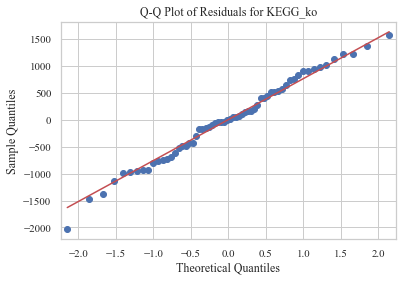


Checking Normality of Residuals for PFAMs...
ShapiroResult(statistic=0.9711736440658569, pvalue=0.1522846668958664)


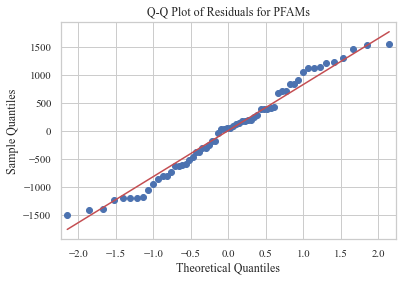


Checking Homogeneity of Variances for KEGG_ko...
LeveneResult(statistic=0.9969320389404517, pvalue=0.4280992926721161)

Checking Homogeneity of Variances for PFAMs...
LeveneResult(statistic=1.1907308288394736, pvalue=0.3254852664649629)


In [120]:
# Check normality of residuals for KEGG_ko
print("\nChecking Normality of Residuals for KEGG_ko...")
print(stats.shapiro(model_kegg.resid))
sm.qqplot(model_kegg.resid, line='s')
plt.title("Q-Q Plot of Residuals for KEGG_ko")
plt.show()

# Check normality of residuals for PFAMs
print("\nChecking Normality of Residuals for PFAMs...")
print(stats.shapiro(model_pfams.resid))
sm.qqplot(model_pfams.resid, line='s')
plt.title("Q-Q Plot of Residuals for PFAMs")
plt.show()

# Check homogeneity of variances for KEGG_ko
print("\nChecking Homogeneity of Variances for KEGG_ko...")
print(stats.levene(*[combined['KEGG_ko'][combined['station'] == s] for s in combined['station'].unique()]))

# Check homogeneity of variances for PFAMs
print("\nChecking Homogeneity of Variances for PFAMs...")
print(stats.levene(*[combined['PFAMs'][combined['station'] == s] for s in combined['station'].unique()]))